
## Увеличение урожайности путем борьбы с сорняками

Сорняки являются нежелательными вторжениями в сельскохозяйственном бизнесе. Нам необходимо обнаружить сорняки и культуры с использованием модели YOLOV8.

Здесь мы можем загрузить набор данных, используя функцию wget, и распаковать загруженный файл, используя функцию unzip:

In [1]:
# Загрузка набора данных Выполняется загрузка архива с набором данных "Weed Detection" с помощью команды wget.
!wget "https://s3-ap-southeast-1.amazonaws.com/he-public-data/Weed_Detection5a431d7.zip"

'wget' is not recognized as an internal or external command,
operable program or batch file.


# Распаковка архива
Выполняется распаковка загруженного архива "Weed_Detection5a431d7.zip" с помощью команды !unzip.

In [2]:
!unzip 'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\Weed_Detection5a431d7.zip'

'unzip' is not recognized as an internal or external command,
operable program or batch file.


In [10]:
import zipfile

# Define the path to the ZIP file and the destination folder
zip_file_path = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\Weed_Detection5a431d7.zip'
destination_folder = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)'

# Unzip the file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(destination_folder)


# Установка библиотеки Ultralytics
Данная команда используется для установки библиотеки Ultralytics. Библиотека Ultralytics предоставляет инструменты для обучения и использования моделей глубокого обучения, в том числе YOLO (You Only Look Once).

Установка производится с помощью команды %pip install ultralytics, где %pip - это магическая команда в Jupyter Notebook, которая позволяет установить пакеты Python прямо в текущем сеансе блокнота. Ultralytics - это название устанавливаемой библиотеки.

После выполнения этой команды в блокноте будет доступна библиотека Ultralytics для использования в дальнейших ячейках блокнота.


In [11]:
%pip install ultralytics


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


# Установка библиотеки split-folders
Эта команда используется для установки библиотеки split-folders. Библиотека split-folders предоставляет инструменты для разделения датасетов на обучающий, валидационный и тестовый наборы.

Установка производится с помощью магической команды *%pip install split-folders* в Jupyter Notebook. После установки библиотеки split-folders можно использовать ее функции для разделения датасетов на указанные наборы.


In [12]:
%pip install split-folders


[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [13]:
# Импорт необходимых библиотек
import os # - os: для работы с файловой системой
import shutil # - shutil: для выполнения операций копирования и перемещения файлов и папок
import math # - math: для выполнения математических операций
import numpy as np # - numpy as np: для работы с массивами и выполнения вычислений
from ultralytics import YOLO # - from ultralytics import YOLO: импорт класса YOLO из библиотеки ultralytics для работы с моделью обнаружения объектов


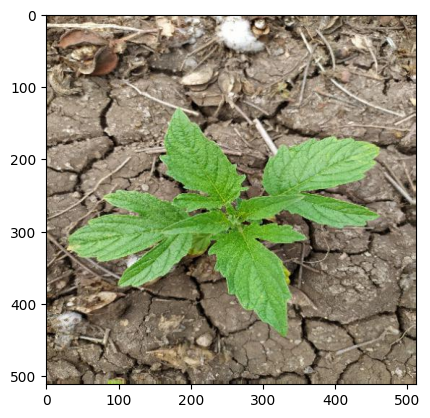

In [15]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Импорт библиотеки для работы с изображениями

img = plt.imread(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data\agri_0_3.jpeg')
# Чтение изображения с помощью функции plt.imread() и сохранение его в переменной img

plt.imshow(img)
# Отображение изображения с помощью функции plt.imshow()

1. Импортирует необходимые библиотеки для работы с файлами и изображениями.
2. Использует функцию `glob.glob()` для поиска всех файлов с расширением .jpeg в указанном пути.
3. Проверяет, есть ли как минимум 5 изображений в найденных файлах.
4. Если найдено как минимум 5 изображений, создает фигуру для размещения подграфиков с помощью `plt.figure()`.
5. Проходит по первым пяти изображениям и отображает их в виде подграфиков с помощью `plt.imshow()`.
6. Отображает результаты, если количество изображений достаточно, и выводит сообщение об ошибке в противном случае.

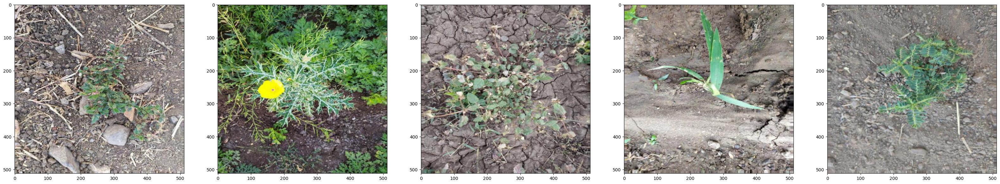

In [16]:
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Импорт библиотек для работы с файлами и изображениями

# Найти все файлы .jpeg в указанном пути
jpeg_files = glob.glob(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data\*.jpeg')

# Проверить, есть ли как минимум 5 изображений
if len(jpeg_files) >= 5:
    # Создать фигуру для размещения подграфиков
    fig = plt.figure(figsize=(40,20))  # Регулируем высоту и ширину фигуры по необходимости

    # Пройти по первым десяти изображениям в полученном списке
    for i in range(5):
        img = plt.imread(jpeg_files[i])
        # Добавить подграфик (расположенный в 1 строке и 5 столбцах)
        ax = fig.add_subplot(1, 5, i+1)
        ax.imshow(img)
    plt.show()

else:
    print("В указанном пути меньше 5 изображений.")


In [17]:
def separate_files(srclocation, deslocation, type_ofImage):
    """
    Функция для разделения файлов из одного расположения в другое по типу изображений.

    Аргументы:
    srclocation (str): Путь к исходному расположению файлов.
    deslocation (str): Путь к целевому расположению файлов.
    type_ofImage (str): Тип изображения для фильтрации.

    Возвращаемое значение:
    None
    """
    # Проверка наличия папки для целевого расположения
    if not os.path.exists("./" + deslocation):
        os.mkdir(deslocation)

    # Получение списка файлов с заданным типом изображения
    files = [t for t in os.listdir(srclocation) if type_ofImage in t.lower()]
    append_path = []
    srclocation = srclocation + '/'

    # Формирование полного пути к файлам
    for txt in files:
        temp = srclocation + (txt)
        append_path.append(temp)

    # Перемещение файлов в целевую папку
    for image in append_path:
        newpath = deslocation + "/"
        shutil.move(image, newpath)


Применение функции separate_files будет осуществлять разделение файлов с расширением .jpeg из папки /content/data в папку images/.

In [18]:
separate_files(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data','images','.jpeg')

Функция separate_files разделит файлы с расширением .txt из папки /content/data и переместит их в папку labels.

In [19]:
separate_files(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data','labels','.txt')

Эти строки кода перемещают папки `labels` и `images` из `/content` внутрь папки `data`.


In [20]:
shutil.move(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\labels',r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data')
shutil.move(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\images',r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data')

'C:\\Users\\Muntadher\\Desktop\\weeb (Обнаружение сорняков)\\data\\images'

Этот код использует библиотеку splitfolders для разделения содержимого папки `/content/data` на обучающий, валидационный и тестовый наборы данных. Обучающий набор составляет `70%` от исходных данных, валидационный и тестовый - по `15%` и `15%` каждый. Разделение выполняется с учетом указанного семени (seed), без префиксов групп (group_prefix), и без перемещения файлов (move=False).


In [21]:
import splitfolders
splitfolders.ratio(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\data','output',seed=1337,ratio=(.7,.15,.15),group_prefix=None,move=False)

Copying files: 0 files [00:00, ? files/s]

Copying files: 2600 files [00:10, 259.80 files/s]


Этот код создает список `testImageCount`, содержащий имена файлов изображений в папке '/content/output/test/images'.


In [22]:
testImageCount = [f for f in os.listdir(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images')]


In [23]:
print("количество файлов изображений",len(testImageCount)) # Этот код возвращает количество файлов изображений в переменной `testImageCount`.

количество файлов изображений 196


Этот код создает список файлов меток в переменной `testLabelCount`, которые находятся в папке '/content/output/test/labels'.


In [24]:
testLabelCount = [f for f in os.listdir(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\labels')]

In [25]:
print("количество файлов меток",len(testLabelCount)) # Этот код возвращает количество файлов меток в переменной `testLabelCount`, которые находятся в папке '/content/output/test/labels'.


количество файлов меток 196


Этот код загружает предварительно обученную модель YOLO из файла "yolov8n.pt".


In [32]:
model = YOLO(r"C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\yolov8n.pt")  # Загрузка предварительно обученной модели YOLOv8n

100%|██████████| 6.23M/6.23M [00:01<00:00, 3.97MB/s]


In [34]:
# Обучение модели на данных, указанных в файле 'custom.yaml' в течение 3 эпох
model.train(data=r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\custom.yaml', epochs=3)

New https://pypi.org/project/ultralytics/8.1.37 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.34 🚀 Python-3.12.0 torch-2.2.1+cpu CPU (Intel Core(TM) i7-6500U 2.50GHz)
engine\trainer: task=detect, mode=train, model=C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\yolov8n.pt, data=C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\custom.yaml, epochs=3, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False

train: Scanning C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\train\labels... 909 images, 0 backgrounds, 0 corrupt: 100%|██████████| 909/909 [00:11<00:00, 80.33it/s] 


train: New cache created: C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\train\labels.cache


val: Scanning C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\val\labels... 195 images, 0 backgrounds, 0 corrupt: 100%|██████████| 195/195 [00:01<00:00, 113.63it/s]


val: New cache created: C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\val\labels.cache
Plotting labels to runs\detect\train2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train2
Starting training for 3 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/3         0G      1.407      2.394      1.696         34        640: 100%|██████████| 57/57 [23:10<00:00, 24.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [02:07<00:00, 18.16s/it]


                   all        195        316      0.537      0.304      0.384      0.191

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/3         0G      1.312      1.802      1.602         45        640: 100%|██████████| 57/57 [20:03<00:00, 21.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [02:36<00:00, 22.38s/it]

                   all        195        316      0.516      0.453      0.519      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/3         0G      1.332      1.631       1.62         34        640: 100%|██████████| 57/57 [27:45<00:00, 29.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [02:13<00:00, 19.03s/it]

                   all        195        316      0.761      0.733      0.766      0.398



3 epochs completed in 1.301 hours.
Optimizer stripped from runs\detect\train2\weights\last.pt, 6.2MB
Optimizer stripped from runs\detect\train2\weights\best.pt, 6.2MB

Validating runs\detect\train2\weights\best.pt...
Ultralytics YOLOv8.1.34 🚀 Python-3.12.0 torch-2.2.1+cpu CPU (Intel Core(TM) i7-6500U 2.50GHz)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [01:31<00:00, 13.14s/it]


                   all        195        316      0.761      0.734      0.766      0.398
                  crop        195        191      0.683      0.754      0.777      0.423
                  weed        195        125       0.84      0.715      0.755      0.372
Speed: 6.6ms preprocess, 421.7ms inference, 0.0ms loss, 25.7ms postprocess per image
Results saved to runs\detect\train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000021D0AE30BC0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [52]:
# from tensorflow.keras.models import load_model, save_model

# # Предполагая, что у вас есть модель Keras с именем 'model'
# # Сохранение модели
# save_model(model.train, '/content/model.h5')

# # Загрузка сохраненной модели
# loaded_model = load_model('/content/model.h5')


In [53]:
# import pickle

# # Предполагая, что у вас есть модель с именем 'model'
# # Сохранение модели с помощью pickle
# with open('/content/model.pkl', 'wb') as f:
#     pickle.dump(model, f)

# # Загрузка сохраненной модели
# with open('/content/model.pkl', 'rb') as f:
#     loaded_model = pickle.load(f)


In [54]:
# import joblib

# # Предполагая, что у вас есть модель с именем 'model'
# # Сохранение модели с помощью joblib
# joblib.dump(model, '/content/model.joblib')

# # Загрузка сохраненной модели
# loaded_model = joblib.load('/content/model.joblib')


Этот код создает список output_images, который содержит имена всех файлов в каталоге '/content/runs/detect/train', но только те, которые имеют расширение ".jpg". Поиск выполняется независимо от регистра, чтобы включить файлы с расширениями ".jpg", ".JPG" и т. д.

In [40]:
output_images = [t for t in os.listdir(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\runs\detect\train2') if '.jpg' in t.lower()]

Список output_images содержит имена всех файлов в каталоге '/content/runs/detect/train', которые имеют расширение ".jpg". Если вы хотите увидеть содержимое этого списка, вы можете вывести его, вызвав его в коде или в интерактивной оболочке Python.

In [41]:
output_images

['labels.jpg',
 'labels_correlogram.jpg',
 'train_batch0.jpg',
 'train_batch1.jpg',
 'train_batch2.jpg',
 'val_batch0_labels.jpg',
 'val_batch0_pred.jpg',
 'val_batch1_labels.jpg',
 'val_batch1_pred.jpg',
 'val_batch2_labels.jpg',
 'val_batch2_pred.jpg']

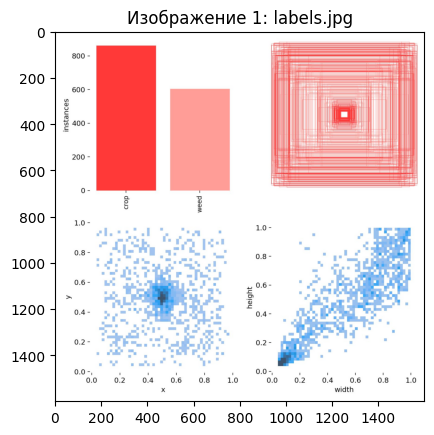

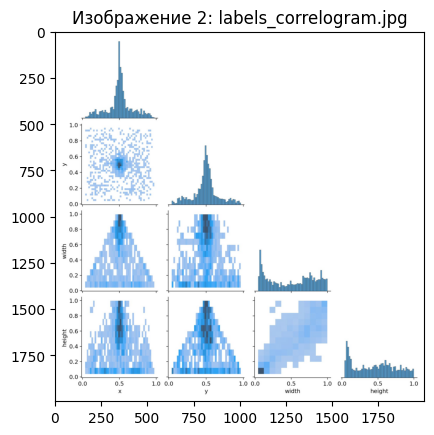

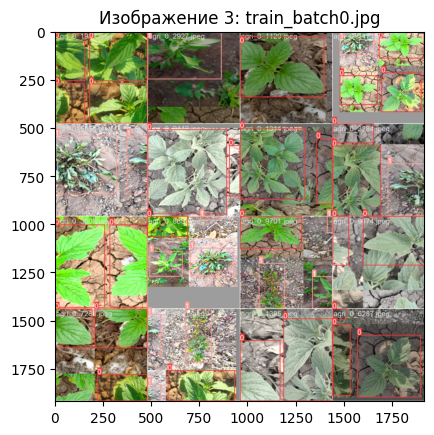

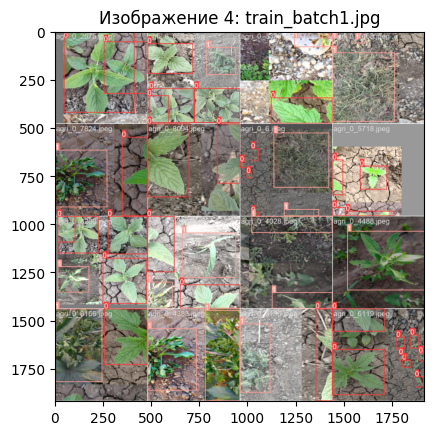

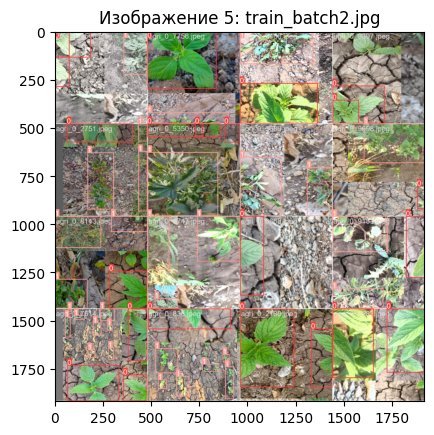

...

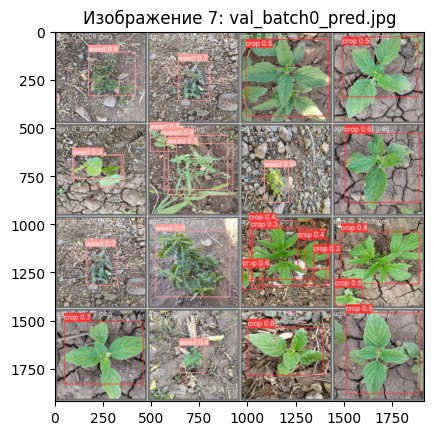

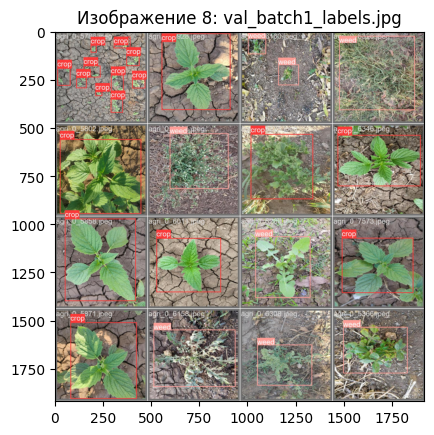

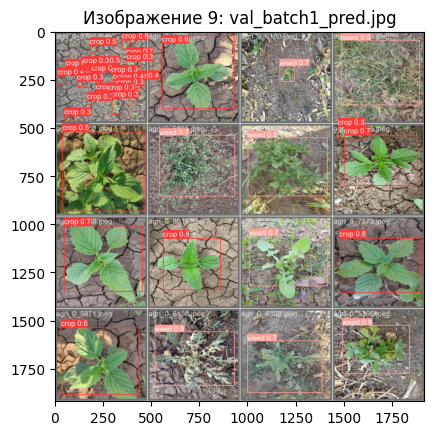

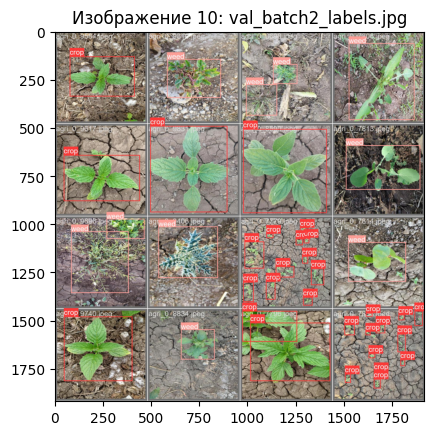

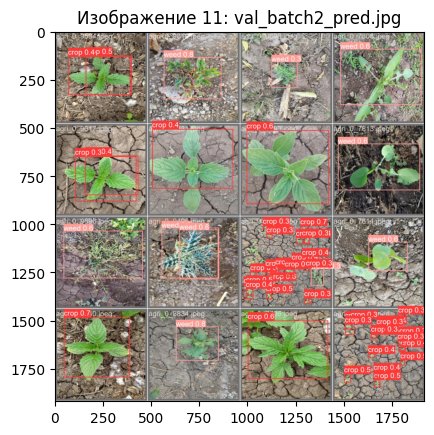

In [51]:
import os
import matplotlib.pyplot as plt

# Основной путь к каталогу с изображениями
main_path = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\runs\detect\train2'
# Фильтрация только JPG изображений
output_images = [f for f in os.listdir(main_path) if f.endswith('.jpg')]
# Итерация по изображениям и их отображение
for i, image in enumerate(output_images):  
    path = os.path.join(main_path, image)  # Формирование полного пути к изображению
    tmp = plt.imread(path)  # Чтение изображения по указанному пути
    plt.imshow(tmp) 
    plt.title(f"Изображение {i+1}: {image}")
    plt.show()  


In [52]:
# Формирование списка изображений PNG в указанной директории
matrix_images = [t for t in os.listdir(r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\runs\detect\train2') if '.png' in t.lower()]


`matrix_images` содержит список имен файлов изображений формата PNG, найденных в директории '/content/runs/detect/train'.

In [53]:
matrix_images

['confusion_matrix.png',
 'confusion_matrix_normalized.png',
 'F1_curve.png',
 'PR_curve.png',
 'P_curve.png',
 'results.png',
 'R_curve.png']

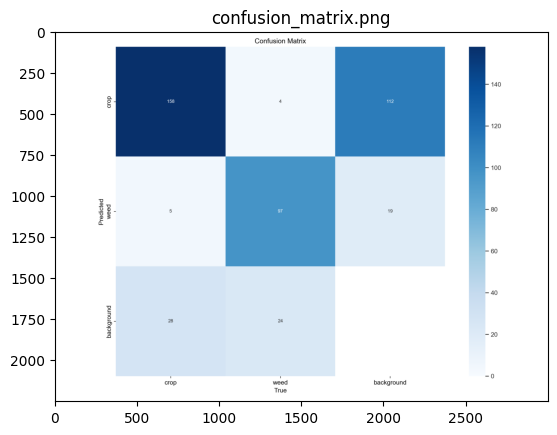

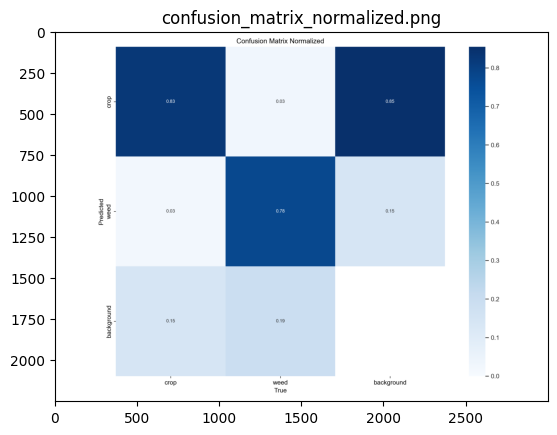

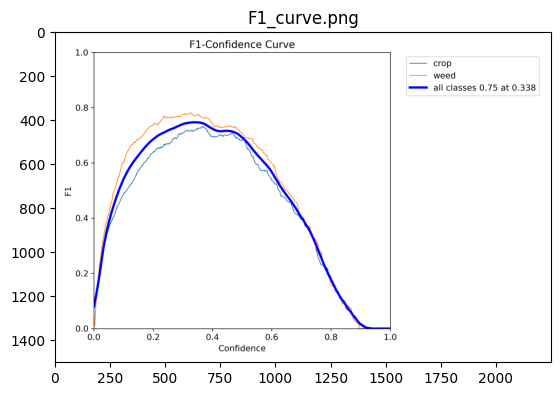

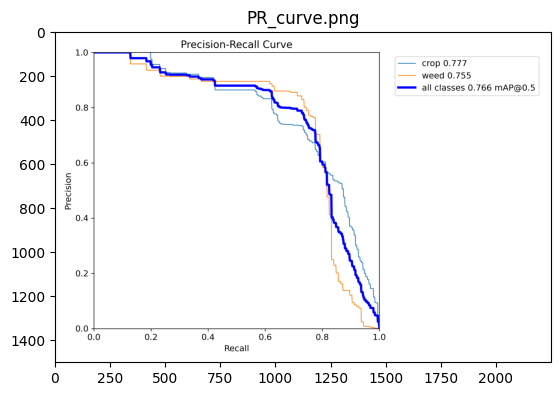

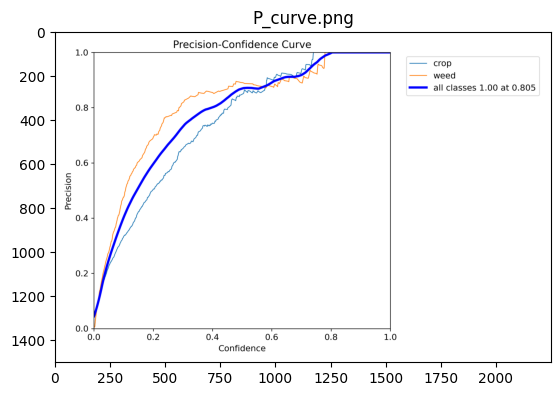

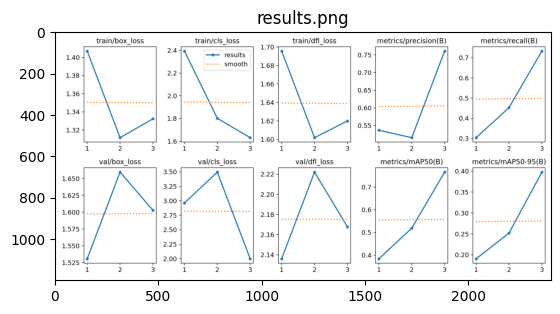

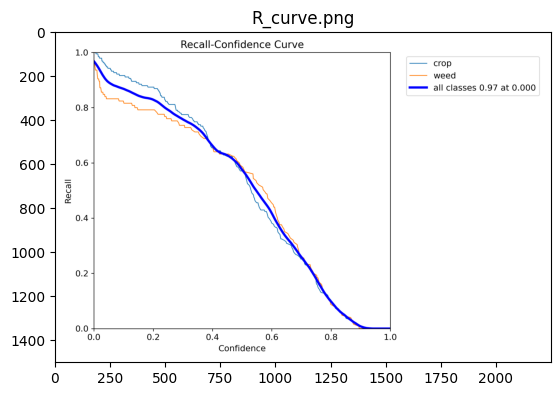

In [91]:
import os
import matplotlib.pyplot as plt

# Основной путь к каталогу с изображениями
main_path = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\runs\detect\train2'

# Цикл для обработки каждого изображения из списка matrix_images
for image in matrix_images:
    path = os.path.join(main_path, image)  # Формирование полного пути к текущему изображению
    tmp = plt.imread(path)  # Загрузка изображения с помощью plt.imread()
    plt.imshow(tmp)  # Отображение изображения
    plt.title(image)  # Установка заголовка изображения как имени файла
    plt.show()  # Отображение изображения


In [92]:
# Создание объекта модели YOLO и загрузка предварительно обученной модели
model1 = YOLO(r'runs/detect/train2/weights/best.pt')

код выполняет валидацию модели model1. Валидация модели обычно включает оценку ее производительности на независимом наборе данных, который не использовался для обучения модели. Результаты валидации могут помочь оценить, насколько хорошо модель обобщает данные и выявляет ее способность к обработке новых, ранее не встречавшихся данных.

In [93]:
# Выполнение валидации модели
model1.val()

Ultralytics YOLOv8.1.34 🚀 Python-3.12.0 torch-2.2.1+cpu CPU (Intel Core(TM) i7-6500U 2.50GHz)
Model summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\val\labels.cache... 195 images, 0 backgrounds, 0 corrupt: 100%|██████████| 195/195 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 13/13 [02:44<00:00, 12.63s/it]


                   all        195        316      0.761      0.734      0.766      0.398
                  crop        195        191      0.683      0.754      0.777      0.423
                  weed        195        125       0.84      0.715      0.755      0.372
Speed: 9.6ms preprocess, 767.9ms inference, 0.0ms loss, 34.0ms postprocess per image
Results saved to runs\detect\val2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x0000021D3CDD1D60>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.0

In [96]:
# Assuming model1 is already loaded or defined
# Make predictions on images
predictions = model1.predict(source=r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images')

# Save the predictions to a file
with open('predictions.txt', 'w', encoding='utf-8') as f:
    for prediction in predictions:
        f.write(str(prediction) + '\n')





image 1/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1026.jpeg: 640x640 1 crop, 3864.0ms
image 2/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1146.jpeg: 640x640 2 weeds, 500.7ms
image 3/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1192.jpeg: 640x640 1 weed, 345.0ms
image 4/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1210.jpeg: 640x640 (no detections), 343.4ms
image 5/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1211.jpeg: 640x640 1 crop, 341.5ms
image 6/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1258.jpeg: 640x640 1 weed, 432.0ms
image 7/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1332.jpeg: 640x640 5 crops, 406.6ms
image 8/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_

In [99]:
# Прогнозирование с использованием модели model1 на изображениях из указанного источника
model1.predict(source=r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images', save=True)



image 1/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1026.jpeg: 640x640 1 crop, 2165.6ms
image 2/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1146.jpeg: 640x640 2 weeds, 651.7ms
image 3/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1192.jpeg: 640x640 1 weed, 415.0ms
image 4/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1210.jpeg: 640x640 (no detections), 407.9ms
image 5/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1211.jpeg: 640x640 1 crop, 331.9ms
image 6/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1258.jpeg: 640x640 1 weed, 334.4ms
image 7/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_0_1332.jpeg: 640x640 5 crops, 329.9ms
image 8/196 C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images\agri_

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'crop', 1: 'weed'}
 obb: None
 orig_img: array([[[ 49,  65,  81],
         [ 56,  72,  88],
         [ 57,  73,  89],
         ...,
         [179, 207, 224],
         [179, 209, 226],
         [178, 208, 225]],
 
        [[ 98, 114, 130],
         [100, 116, 132],
         [ 98, 114, 130],
         ...,
         [146, 174, 191],
         [139, 169, 186],
         [134, 164, 181]],
 
        [[100, 116, 132],
         [101, 117, 133],
         [103, 119, 135],
         ...,
         [178, 205, 225],
         [182, 212, 231],
         [181, 211, 230]],
 
        ...,
 
        [[ 11,  11,  29],
         [  9,  11,  29],
         [  2,   5,  20],
         ...,
         [ 99, 112, 128],
         [ 98, 111, 127],
         [100, 113, 129]],
 
        [[ 23,  21,  40],
         [ 27,  27,  45],
         [ 26,  26,  42],
         ...,
         

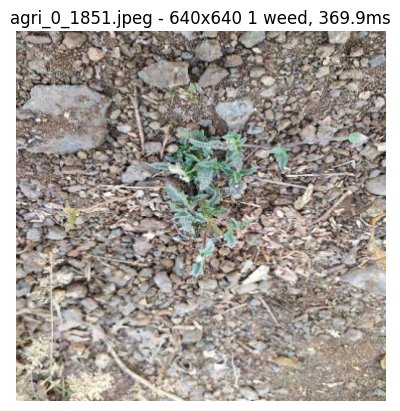

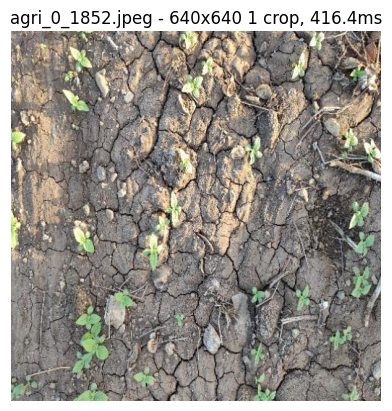

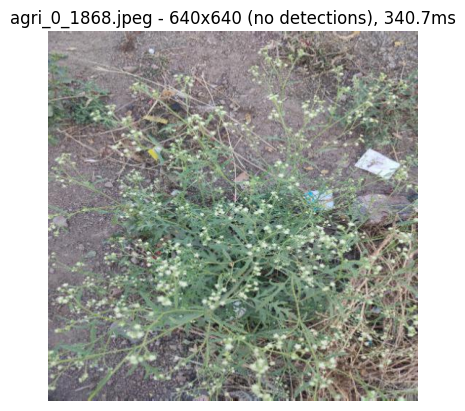

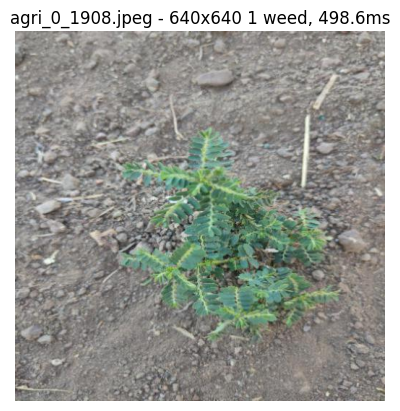

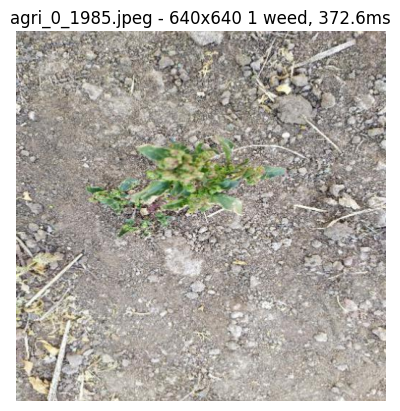

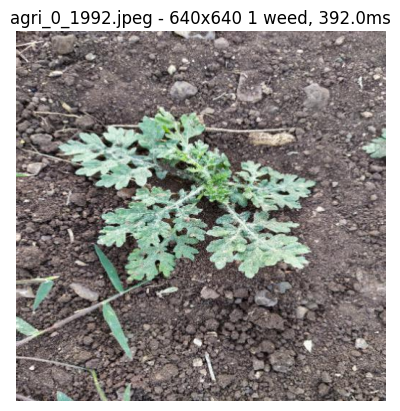

In [101]:
import os
import matplotlib.pyplot as plt

# Directory containing the images
image_dir = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\output\test\images'

# List of images with their detections
image_data = [
    "agri_0_1851.jpeg: 640x640 1 weed, 369.9ms",
    "agri_0_1852.jpeg: 640x640 1 crop, 416.4ms",
    "agri_0_1868.jpeg: 640x640 (no detections), 340.7ms",
    "agri_0_1908.jpeg: 640x640 1 weed, 498.6ms",
    "agri_0_1985.jpeg: 640x640 1 weed, 372.6ms",
    "agri_0_1992.jpeg: 640x640 1 weed, 392.0ms",
    # Add more image data here...
]

# Loop through the image data
for image_info in image_data:
    # Extract image filename and detections
    image_info_parts = image_info.split(':')
    image_filename = image_info_parts[0].strip()
    detections_info = image_info_parts[1].strip()

    # Load and display the image
    image_path = os.path.join(image_dir, image_filename)
    image = plt.imread(image_path)
    plt.imshow(image)
    plt.title(f"{image_filename} - {detections_info}")
    plt.axis('off')
    plt.show()


In [60]:
# Импорт библиотеки для монтирования Google Диска
from google.colab import drive

# Монтирование Google Диска
drive.mount('/content/drive')


Mounted at /content/drive


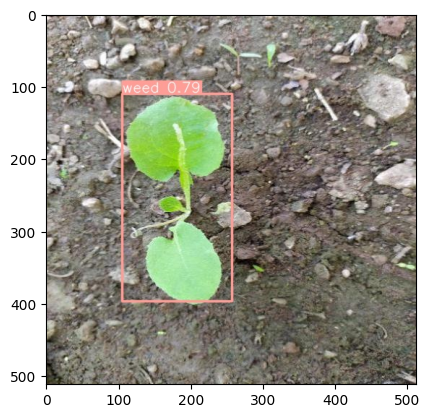

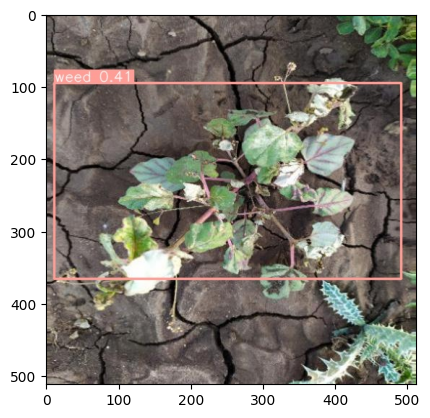

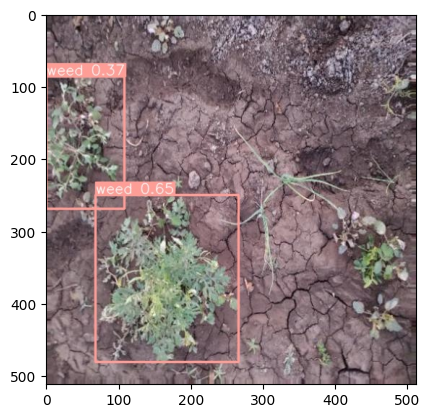

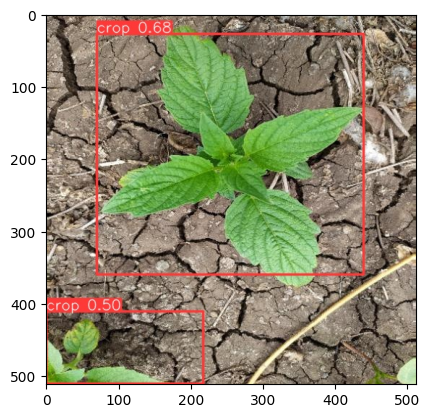

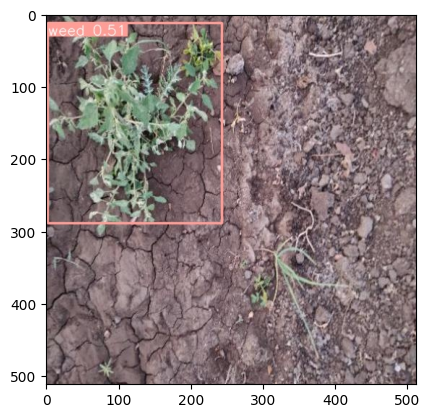

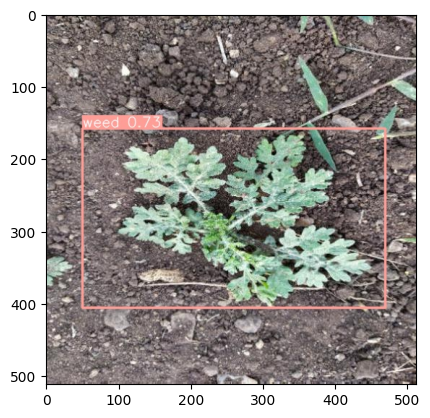

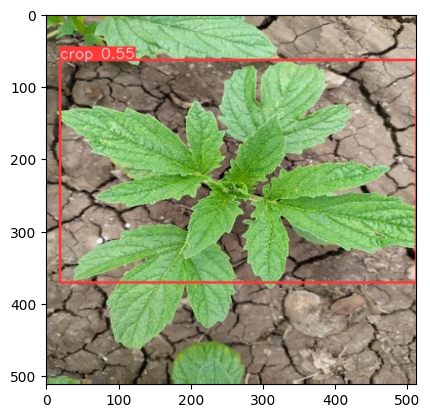

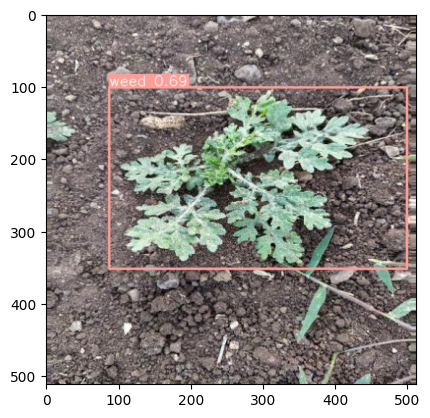

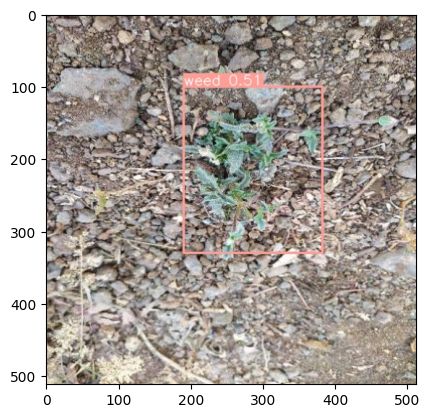

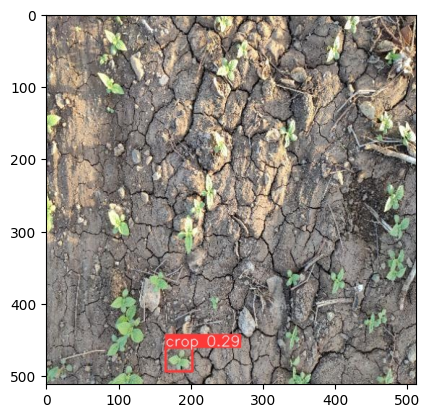

In [110]:
import os
import matplotlib.pyplot as plt

# Directory containing the predicted images
predict_path = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\runs\detect\predict'

# List predicted images
predicted_images = [t for t in os.listdir(predict_path) if t.lower().endswith('.jpeg')]

# Select a subset of images for display
sample_images = predicted_images[10:20]

# Display selected images
for image in sample_images:
    # Construct the full path to the image
    image_path = os.path.join(predict_path, image)
    
    # Load and display the image
    tmp = plt.imread(image_path)
    plt.imshow(tmp)
    plt.grid(False)
    plt.show()


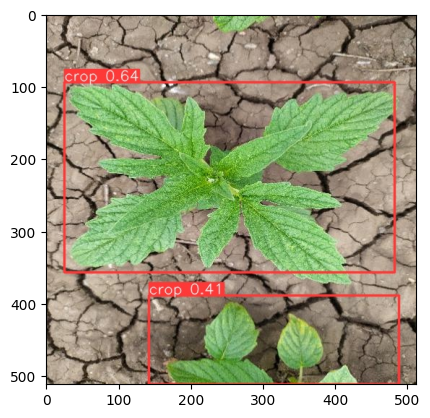

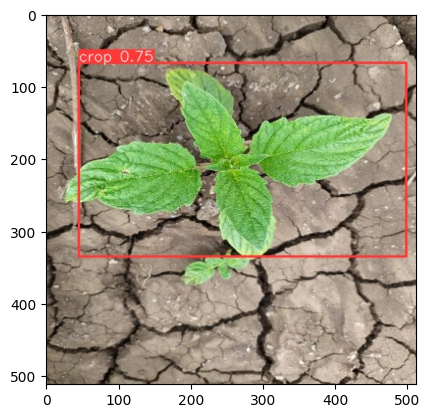

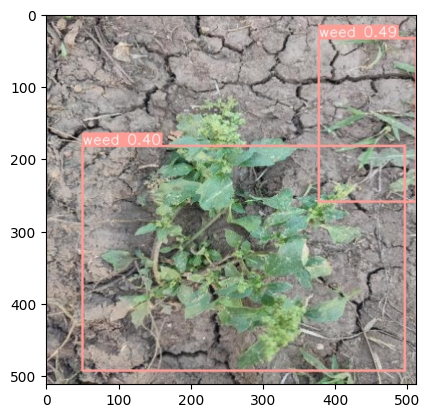

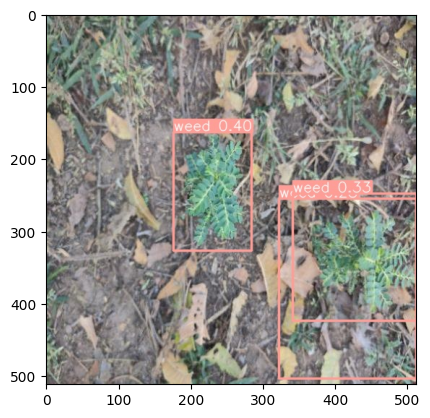

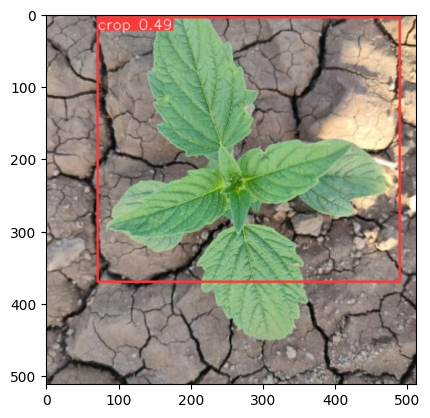

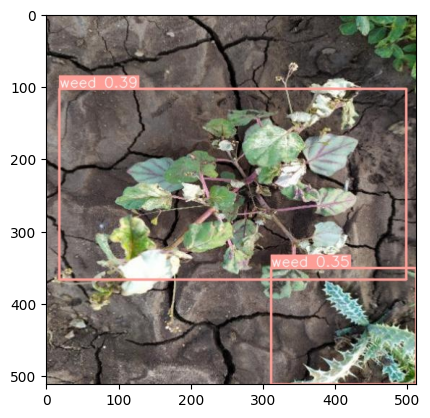

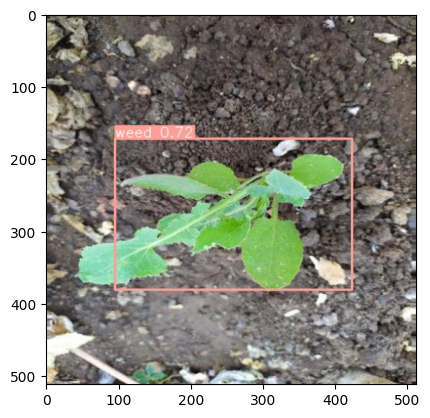

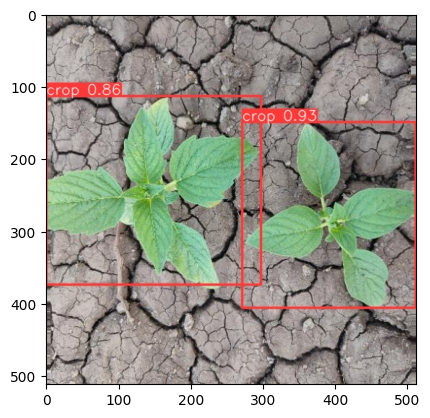

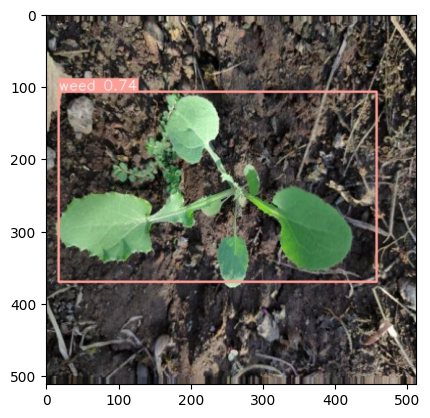

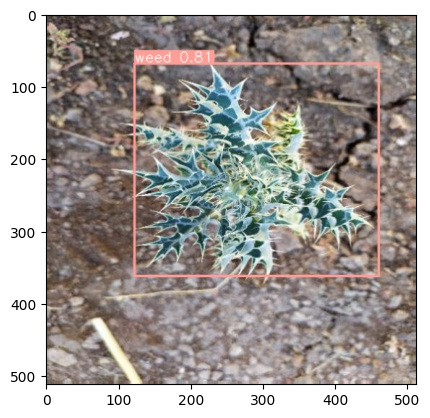

In [111]:
import os
import matplotlib.pyplot as plt

# Directory containing the predicted images
predict_path = r'C:\Users\Muntadher\Desktop\weeb (Обнаружение сорняков)\runs\detect\predict'

# List predicted images
predicted_images = [t for t in os.listdir(predict_path) if t.lower().endswith('.jpeg')]

# Select a subset of images for display
sample_images = predicted_images[30:40]

# Display selected images
for image in sample_images:
    # Construct the full path to the image
    image_path = os.path.join(predict_path, image)
    
    # Load and display the image
    tmp = plt.imread(image_path)
    plt.imshow(tmp)
    plt.grid(False)
    plt.show()




Чтобы сохранить модель на вашем компьютере, вы можете воспользоваться различными методами в зависимости от фреймворка машинного обучения, который вы используете. Вот несколько общих методов для различных фреймворков:

In [70]:
# Сохранение модели в формате Keras
model.save('my_model.h5')


Чтобы использовать сохраненную модель повторно, вам нужно загрузить ее из файла и затем использовать для предсказаний или обучения, в зависимости от ваших потребностей. Вот как это можно сделать для различных фреймворков:

In [64]:
import torch
# Сохранение модели
torch.save(model.state_dict(), 'my_model.pth')


In [68]:
print(type(model))

<class 'ultralytics.models.yolo.model.YOLO'>


In [69]:
# Сохранение модели с помощью pickle
import pickle


with open('my_model.pkl', 'wb') as f:
    pickle.dump(model.state_dict(), f)

